# EDA on Wine Quality Dataset and Wine Review Dataset

References:
- https://www.digitalocean.com/community/tutorials/exploratory-data-analysis-python  
- https://towardsdatascience.com/exploratory-data-analysis-in-python-a-step-by-step-process-d0dfa6bf94ee  
- https://manuelenolli.github.io/wine-enthusiast-analysis/
- https://www.winemag.com/our-buying-guide-and-blind-tasting-process/

## 1) Wine Quality Dataset
 
Source: https://archive.ics.uci.edu/ml/datasets/wine+quality  
Citation: P. Cortez, A. Cerdeira, F. Almeida, T. Matos and J. Reis. Modeling wine preferences by data mining from physicochemical properties. In Decision Support Systems, Elsevier, 47(4):547-553, 2009.

Dummy Variable(Red = 1, White = 0)is used to put separated red wine dataset and white wine dataset together.

The two datasets are related to red and white variants of the Portuguese "Vinho Verde" wine.
Due to privacy and logistic issues, only physicochemical (inputs) and sensory (the output) variables are available (e.g. there is no data about grape types, wine brand, wine selling price, etc.).

In [1]:
# Importing Libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import rcParams
import os
import seaborn as sns

import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

# styling
plt.style.use("ggplot")
rcParams['figure.figsize'] = (12, 6)

In [2]:
wines = pd.read_csv('datasets/winequality-all.csv')
wines.head(10)  # breifly check the data

,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,1,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,1,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,1,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,1,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
5,1,7.4,0.66,0.00,1.8,0.075,13.0,40.0,0.9978,3.51,0.56,9.4,5
6,1,7.9,0.60,0.06,1.6,0.069,15.0,59.0,0.9964,3.30,0.46,9.4,5
7,1,7.3,0.65,0.00,1.2,0.065,15.0,21.0,0.9946,3.39,0.47,10.0,7
8,1,7.8,0.58,0.02,2.0,0.073,9.0,18.0,0.9968,3.36,0.57,9.5,7
9,1,7.5,0.50,0.36,6.1,0.071,17.0,102.0,0.9978,3.35,0.80,10.5,5


### Information about data

There is 11 inputs variables and 1 output variable('quality'), and 1 dummy variable('type').

In [3]:
# Basic information about data 
wines.info()
wines.describe()  #decriptive statistics

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   type                  6497 non-null   int64  
 1   fixed acidity         6497 non-null   float64
 2   volatile acidity      6497 non-null   float64
 3   citric acid           6497 non-null   float64
 4   residual sugar        6497 non-null   float64
 5   chlorides             6497 non-null   float64
 6   free sulfur dioxide   6497 non-null   float64
 7   total sulfur dioxide  6497 non-null   float64
 8   density               6497 non-null   float64
 9   pH                    6497 non-null   float64
 10  sulphates             6497 non-null   float64
 11  alcohol               6497 non-null   float64
 12  quality               6497 non-null   int64  
dtypes: float64(11), int64(2)
memory usage: 660.0 KB


,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000
mean,0.246114,7.215307,0.339666,0.318633,5.443235,0.056034,30.525319,115.744574,0.994697,3.218501,0.531268,10.491801,5.818378
std,0.430779,1.296434,0.164636,0.145318,4.757804,0.035034,17.749400,56.521855,0.002999,0.160787,0.148806,1.192712,0.873255
min,0.000000,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,0.000000,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.000000,0.992340,3.110000,0.430000,9.500000,5.000000
50%,0.000000,7.000000,0.290000,0.310000,3.000000,0.047000,29.000000,118.000000,0.994890,3.210000,0.510000,10.300000,6.000000
75%,0.000000,7.700000,0.400000,0.390000,8.100000,0.065000,41.000000,156.000000,0.996990,3.320000,0.600000,11.300000,6.000000
max,1.000000,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


In [4]:
# Duplicate values
wines.duplicated().sum()

# Dropping duplicated and na values 
wines = wines.drop_duplicates()
wines = wines.dropna()

# Descriptive statistics after cleaning
wines.describe()

,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000
mean,0.255451,7.215179,0.344130,0.318494,5.048477,0.056690,30.036654,114.109023,0.994535,3.224664,0.533357,10.549241,5.795677
std,0.436155,1.319671,0.168248,0.147157,4.500180,0.036863,17.805045,56.774223,0.002966,0.160379,0.149743,1.185933,0.879772
min,0.000000,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,0.000000,6.400000,0.230000,0.240000,1.800000,0.038000,16.000000,74.000000,0.992200,3.110000,0.430000,9.500000,5.000000
50%,0.000000,7.000000,0.300000,0.310000,2.700000,0.047000,28.000000,116.000000,0.994650,3.210000,0.510000,10.400000,6.000000
75%,1.000000,7.700000,0.410000,0.400000,7.500000,0.066000,41.000000,153.250000,0.996770,3.330000,0.600000,11.400000,6.000000
max,1.000000,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


In [5]:
# filter the data based on type for further use
red = wines[wines['type']==0]
white = wines[wines['type']==1]

In [6]:
# Percentage of red and white wines distribution
wines.type.value_counts(normalize=True)

0    0.744549
1    0.255451
Name: type, dtype: float64

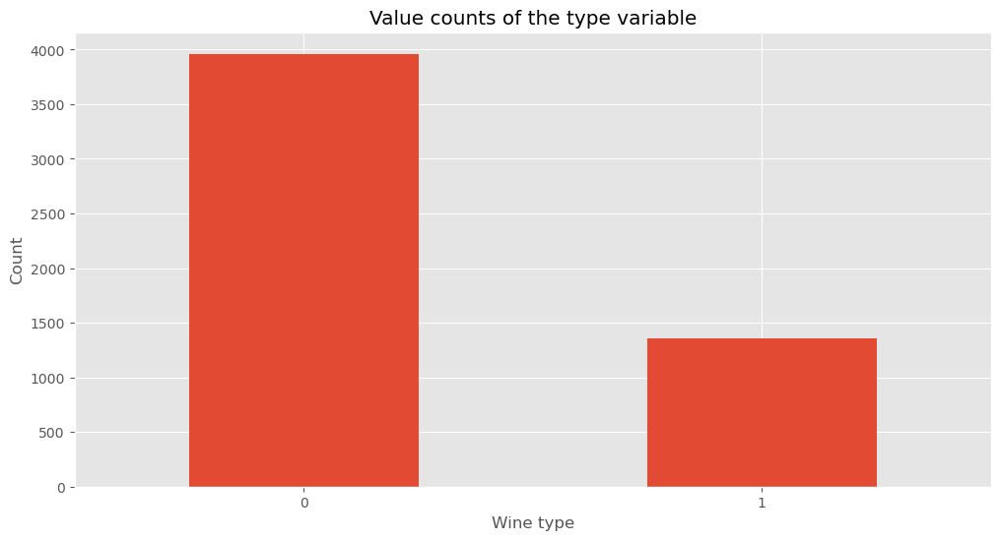

In [7]:
# Plot the distribution of wine types (Red = 0, White = 1)
wines.type.value_counts().plot(kind="bar")
plt.title("Value counts of the type variable")
plt.xlabel("Wine type")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

In [8]:
qualityDistribution = px.histogram(wines, x="quality", title = "Distribution of Quality", height=500)
qualityDistribution.update_xaxes(title="Quality", dtick=1)
qualityDistribution.update_yaxes(title="Count")

### Relationship between variables

With concentrating on the output variable, 'quality', we can see that the 'alcohol' has a relatively high positive correlation with the 'quality', and the 'density' has a negative correlation with the 'quality'. 
We will look for the causality in further research by using simple OLS in preliminary study. 

Also, we can see that correlations between diferent variables are mostly strong. For example, ALCOHOL is strongly associated with DENSITY, PH with FIXED ACIDITY, and CITRIC ACID with VOLATILE ACIDITY. In addition, it is interesting to see which variable are strongly correlated to our dependenat variable Y. It looks like VOLATILE ACIDITY and ALCOHOL have the strongest correlation, followed by CHLORIDES, SULFUR DIOXIDE, SULPATES, and DENSITY. Moreover, we see that the correlation is strong and negative - as there is less CHLORIDES, fo example, the quality rises. It should be kept in mind on the stage of selectiong variables that influence Y variable the most and the least.

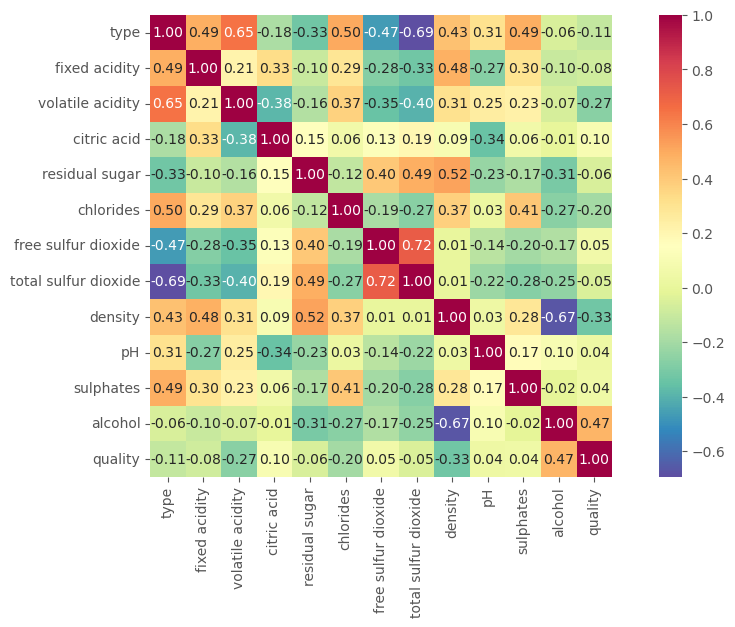

In [9]:
# Correlation heatmap
hm = sns.heatmap(wines.corr(), cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size':10}, yticklabels=wines.columns, 
                 xticklabels=wines.columns,cmap="Spectral_r")
plt.show()

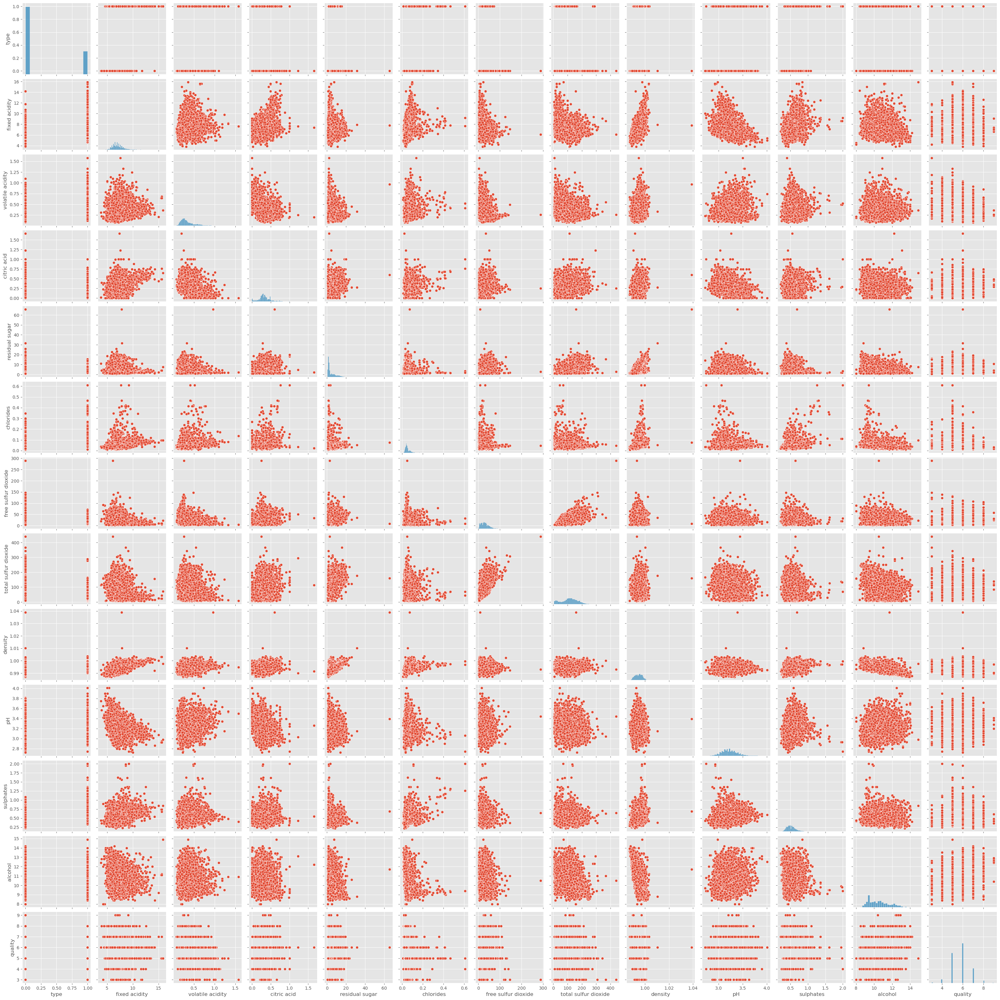

In [10]:
# Relationships between variables
sns.pairplot(wines)

From this scatter matrix we can get an idea of correltion between different variables visually, which gives a slightly different perspective from correlation matrix we have seen before. We can quickly see wich relationships are string and what direction they have. For example, as mentioned before - PH and FIXED ACIDITY have really strong negative correlation. Furthermore, we cn glance at how values for the variables are distributed and we can see that data is mostly skewed right - mean would overestimate the most common values, thus, taking median would give a greaterinsight into the data.

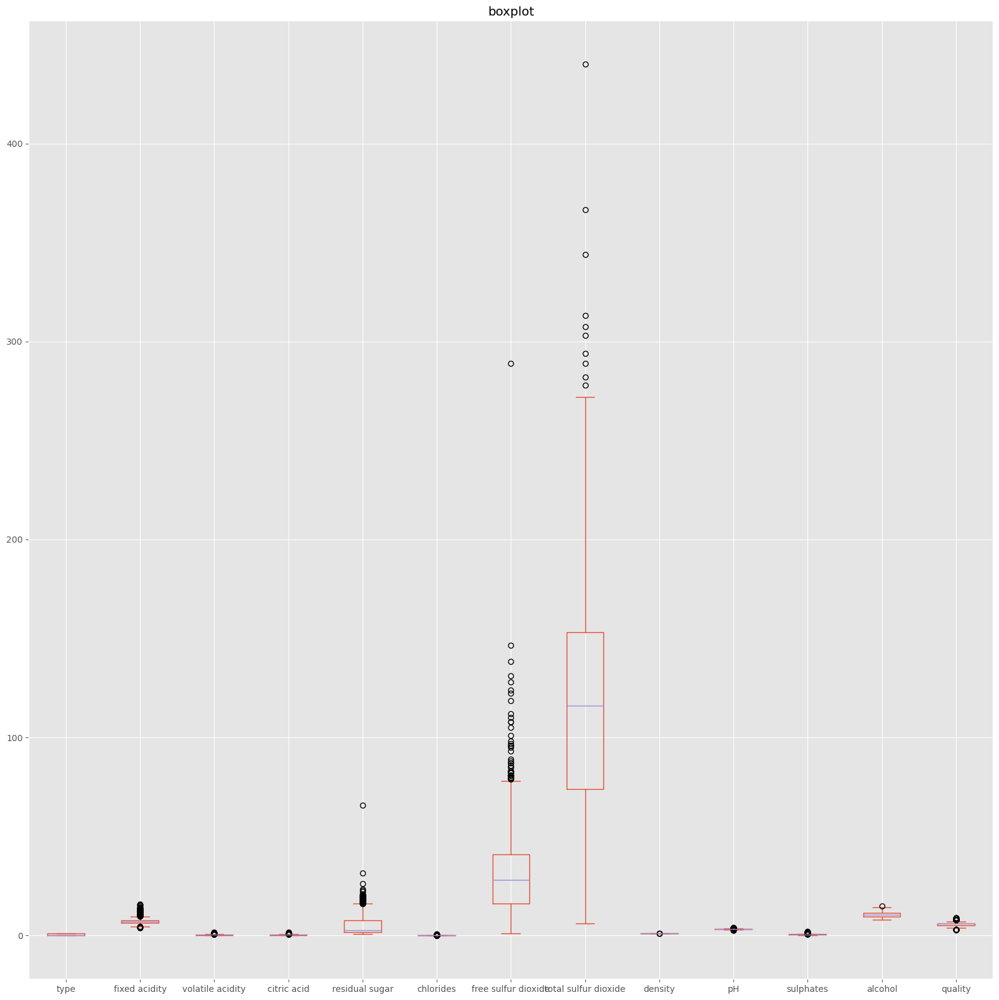

In [11]:
# Boxplots
ax = wines.plot(kind='box', title='boxplot',figsize = (20, 20))
plt.show()

To look at the nature of data distribution I touch on in the last cell - here are the boxplots. We can see that there are a lot of outliers towards right side - skeweness to the right, supporting our scatter matrix above. Additionally, a valuable insight is that TOTAL SULFUR DIOXIDE, FREE SULFUR DIOXIDE, and RESIDUAL SUGAR have a lot of outliers. This tells us that there are a lot of extreme values for those variables that are significatly different from the rest of the data. This can be an indication that there may be errors or anomalies in the data. Looking at our scatter matrix above we can see that, indeed, these variables are not normally distributed. It could have happened because of many factors - measurement error, natural variation, processing errors, sampling bias, etc.

## 2) Wine Reviews Dataset

Source: https://www.kaggle.com/datasets/zynicide/wine-reviews  
The data was scraped from http://www.winemag.com/?s=&drink_type=wine during 2017. 


**Data Description** 
- ```country```: the country of origin of wine
- ```description```: a few sentences from a sommelier describing the wine's taste, smell, look, feel, etc.
- ```designation```: the vineyard within the winery where the grapes that made the wine are from
- ```points```: the number of points WineEnthusiast rated the wine on a scale of 1-100 (though they say they only post reviews for wines that score >=80)
- ```price```: the cost for a bottle of the wine
- ```province```: the province or state that the wine is from
- ```region_1```: the wine growing area in a province or state (ie Napa)
- ```region_2```: sometimes there are more specific regions specified within a wine growing area (ie Rutherford inside the Napa Valley), but this value can sometimes be blank
- ```taster_name```: name of the person who tasted and reviewed the wine
- ```taster_photo```: url of the taster's photo
- ```taster_twitter_handle```: Twitter handle for the person who tasted and reviewed the wine
- ```title```: the title of the wine review
- ```variety```: the type of grapes used to make the wine (ie Pinot Noir)
- ```vintage```: the vintage of the wine
- ```winery```: the winery that made the wine

In [12]:
wines2 = pd.read_csv('datasets/winemag-data-130k-v2.csv')
wines2.sample(5)  # breifly check the data

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
118619,118619,Italy,"Bright and simple, this has delicate aromas of...",NaN,86,25.0,Sicily & Sardinia,Erice,NaN,Kerin O’Keefe,@kerinokeefe,Fazio 2015 Müller-Thurgau (Erice),Müller-Thurgau,Fazio
77197,77197,US,This dry appetizing wine comes from one of Lod...,Zeal,90,22.0,California,Lodi,Central Valley,Jim Gordon,@gordone_cellars,Markus Wine Co 2016 Zeal Rosé (Lodi),Rosé,Markus Wine Co
125976,125976,Italy,"Enticing scents of acacia flower, chopped herb...",NaN,90,16.0,Tuscany,Vernaccia di San Gimignano,NaN,Kerin O’Keefe,@kerinokeefe,La Lastra 2015 Vernaccia di San Gimignano,Vernaccia,La Lastra
14522,14522,Chile,"Dark-fruit aromas are fairly oaky, and thus th...",Trisquel,88,19.0,Colchagua Valley,NaN,NaN,Michael Schachner,@wineschach,Aresti 2014 Trisquel Cabernet Sauvignon (Colch...,Cabernet Sauvignon,Aresti
109849,109849,Italy,"This radiant, fragrant Nebbiolo opens with a p...",Sassella Vigna Regina Riserva,96,105.0,Lombardy,Valtellina Superiore,NaN,Kerin O’Keefe,@kerinokeefe,Arpepe 2007 Sassella Vigna Regina Riserva (Va...,Nebbiolo,Arpepe


In [13]:
wines2 = wines2.drop('Unnamed: 0', axis=1)  # drop first index column
wines2 = wines2.drop('region_2', axis =1)  # drop 'region_2' column. 
# 'region_2' is indicating more specific regions but most of the times, it is blanked.

In [14]:
wines2.sample(3)

,country,description,designation,points,price,province,region_1,taster_name,taster_twitter_handle,title,variety,winery
55643,Portugal,With dense tannins and already generous and op...,VZ Vintage,93,70.0,Port,NaN,Roger Voss,@vossroger,Quinta Vale Dona Maria 2015 VZ Vintage (Port),Port,Quinta Vale Dona Maria
10421,US,From the relatively hot South Coast comes a bi...,Signature Reserve,91,62.0,California,South Coast,Matt Kettmann,@mattkettmann,Hawk Watch Winery 2011 Signature Reserve Caber...,Cabernet Sauvignon,Hawk Watch Winery
18277,Italy,"Chalky and dry on the nose, with notes of mine...",Amaranto,88,19.0,Tuscany,Maremma Toscana,NaN,NaN,Podere San Cristoforo 2010 Amaranto (Maremma ...,Sangiovese,Podere San Cristoforo


In [15]:
wines2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129971 entries, 0 to 129970
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   country                129908 non-null  object 
 1   description            129971 non-null  object 
 2   designation            92506 non-null   object 
 3   points                 129971 non-null  int64  
 4   price                  120975 non-null  float64
 5   province               129908 non-null  object 
 6   region_1               108724 non-null  object 
 7   taster_name            103727 non-null  object 
 8   taster_twitter_handle  98758 non-null   object 
 9   title                  129971 non-null  object 
 10  variety                129970 non-null  object 
 11  winery                 129971 non-null  object 
dtypes: float64(1), int64(1), object(10)
memory usage: 11.9+ MB


### Distribution of Quality (Points) and Price

count    129971.000000
mean         88.447138
std           3.039730
min          80.000000
25%          86.000000
50%          88.000000
75%          91.000000
max         100.000000
Name: points, dtype: float64

Rating skewness is 0.04592075245532028, which means it is skewed a little bit to the right


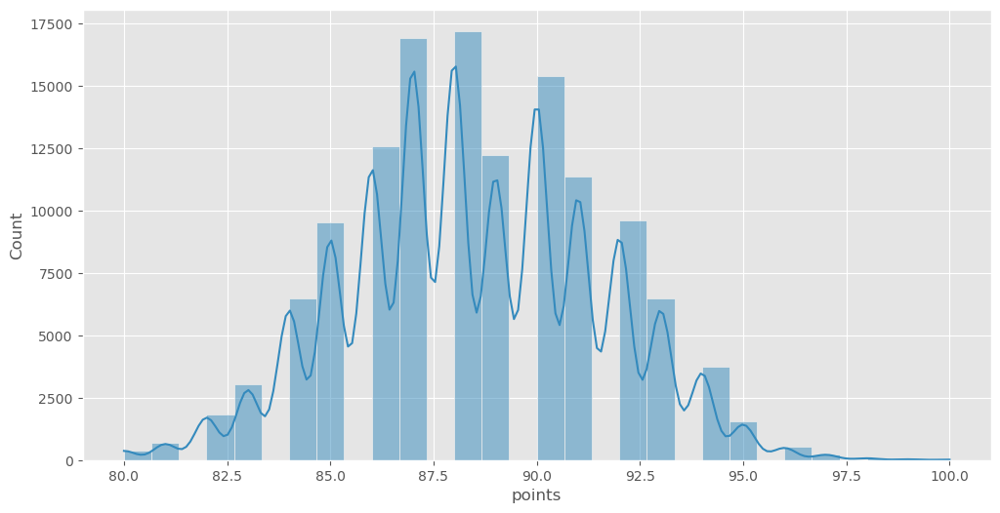

In [16]:
# Skewness of the `points` variable
print(wines2.describe()['points'])
print(f"\nRating skewness is {wines2['points'].skew()}, which means it is skewed a little bit to the right")
sns.histplot(wines2['points'], kde=True, bins=30)
plt.show()

count    120975.000000
mean         35.363389
std          41.022218
min           4.000000
25%          17.000000
50%          25.000000
75%          42.000000
max        3300.000000
Name: price, dtype: float64

Price skewness is 18.000957415874364, which means it is skewed highly to the right;we would need to look at log tranformers to make it nicer


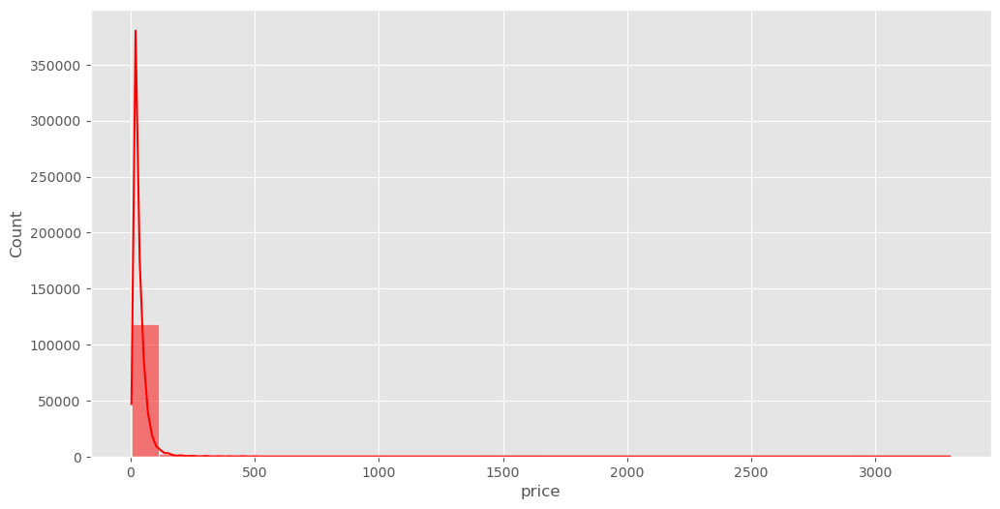

In [17]:
# Skewness of `price` variable
print(wines2.describe()['price'])
print(f"\nPrice skewness is {wines2['price'].skew()}, which means it is skewed highly to the right;we would need to look at log tranformers to make it nicer")
sns.histplot(wines2['price'], kde=True, bins=30, color = 'red')
plt.show()

We will use 6 categories used in WineEnthusiast to group the wine with their points. ``pointsDescription`` is added to the column to contain the description of the points.

- **80–82: ACCEPTABLE** Can be employed in casual, less-critical circumstances
- **83–86: GOOD** Suitable for everyday consumption; often good value
- **87–89: VERY GOOD** Often good value; well recommended
- **90–93: EXCELLENT** Highly recommended
- **94–97: SUPERB** A great achievement
- **98–100: CLASSIC** The pinnacle of quality

From the histogram, the wines in the middle range quality, **Good** and **Very good** are most common, followed by **Excellent**.

In [18]:
#Create new column, pointsDescription
def addPointsDescription(points):
    if points < 83:
        val = 'Acceptable'
    elif points < 87:
        val = 'Good'
    elif points < 90:
        val = 'Very good'
    elif points <93:
        val = 'Excellent'
    elif points <97:
        val = 'Superb'
    else:
        val = 'Classic'

    return val

#Create new column with points description
wines2['pointsDescription'] = wines2['points'].map(addPointsDescription)

In [19]:
#Histogram of points description
pointDistribution = px.histogram(wines2, x='points', color='pointsDescription', title='Distribution of Quality(points)', height=500,
 category_orders=dict(pointsDescription=['Classic', 'Superb', 'Excellent', 'Very good', 'Good','Acceptable']), 
                  labels={
                     "pointsDescription": "Point Description"
                 },
                 color_discrete_map = {'Classic':'#903f5c','Superb':'#006179','Excellent':'#008377','Very good':'#09a259', 'Good':'#90b827', 'Acceptable':'#ffbf00'}

)
#Update axis
pointDistribution.update_xaxes(title='Point',tickmode='linear')
pointDistribution.update_yaxes(title='Count')

pointDistribution.show()

### Relationship between quality and prices

Since most of the variables in this dataset are categorical, we will see the correlation between quality and prices, numerical variables only.

We can see a rough positive relationship between price and points, but we will treat this on the preliminary analysis in detail. 

<AxesSubplot:xlabel='price', ylabel='points'>

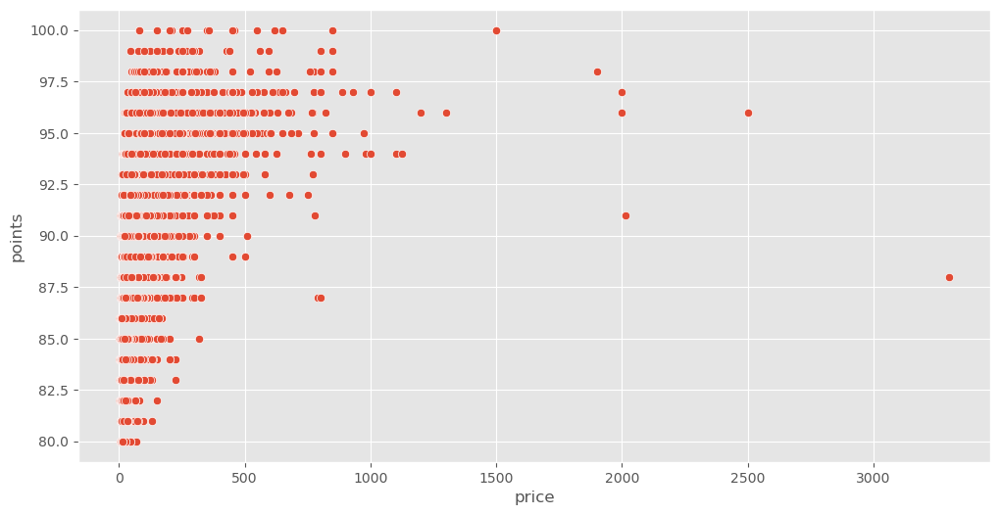

In [20]:
sns.scatterplot(x='price', y='points', data=wines2)

In [21]:
corr = wines2['points'].corr(wines2['price'])
corr

0.4161667418606225

Similar with the quality distribution, I will add ``priceDescription`` to categorize the price of wines.

- **0-20 USD: Low**
- **21-50 USD: Medium**
- **51-100 USD: Expensive**
- **100+ USD: Luxury**

In [22]:
#Function to create a new column with the price range
def addPriceDescription(price):
    if price <= 20:
        val = 'Low'
    elif price <= 50:
        val = 'Medium'
    elif price <= 100:
        val = 'Expensive'
    else:
        val = 'Luxury'
    return val

wines2['priceDescription'] = wines2['price'].map(addPriceDescription)

In [23]:
averagepricePoint = px.histogram(wines2,x='points', color='priceDescription', barmode='stack', barnorm='percent',
 category_orders=dict(priceDescription=['Low', 'Medium', 'Expensive', 'Luxury']), title='Price distribution and Quality(points)', labels={
                     "priceDescription": "Price Description"
                 }, color_discrete_sequence=px.colors.sequential.Teal
                 )

averagepricePoint.update_xaxes(title='Point', dtick=1)
averagepricePoint.update_yaxes(title='Count(%)')

averagepricePoint.show()

### Distribution of wines across the world

To see the distribution of the wines across the continents and countries, new column named `continent` is added.

In [24]:
print(wines2['country'].unique())

['Italy' 'Portugal' 'US' 'Spain' 'France' 'Germany' 'Argentina' 'Chile'
 'Australia' 'Austria' 'South Africa' 'New Zealand' 'Israel' 'Hungary'
 'Greece' 'Romania' 'Mexico' 'Canada' nan 'Turkey' 'Czech Republic'
 'Slovenia' 'Luxembourg' 'Croatia' 'Georgia' 'Uruguay' 'England' 'Lebanon'
 'Serbia' 'Brazil' 'Moldova' 'Morocco' 'Peru' 'India' 'Bulgaria' 'Cyprus'
 'Armenia' 'Switzerland' 'Bosnia and Herzegovina' 'Ukraine' 'Slovakia'
 'Macedonia' 'China' 'Egypt']


In [25]:
#Ditrubution of the wines by continent
pieCountries = px.pie(wines2, names='country', title='Distribution of Wines Across Countries')
pieCountries.update_traces(textposition='inside', textinfo='percent+label')
pieCountries.update(layout_showlegend=False)

pieCountries.show()

In [26]:
#Continent list
europe = ['Austria', 'Bosnia and Herzegovina','Bulgaria','Croatia','Cyprus','Czech Republic','England', 'France','Germany','Greece','Italy','Luxembourg','Portugal','Hungary', 'Macedonia', 'Moldova', 'Romania', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Switzerland', 'Turkey', 'Ukraine']
northAmerica = ['Canada','US','Mexico']

# Define a function to distinguish continent for each country
def classifyContinent(row):
    if row['country'] in europe:
        val = 'Europe'
    elif row['country'] in northAmerica:
        val = "North America"
    else:
        val = 'Other'
    return val

# Add continent varaible to each row
wines2['continent'] = wines2.apply(classifyContinent, 1)

In [27]:
wines2.sample()

,country,description,designation,points,price,province,region_1,taster_name,taster_twitter_handle,title,variety,winery,pointsDescription,priceDescription,continent
82090,US,"This sparkling rosé has raspberry on the nose,...",Sparkling Rosé,86,35.0,Virginia,Monticello,Matt Kettmann,@mattkettmann,Trump 2010 Sparkling Rosé (Monticello),Champagne Blend,Trump,Good,Medium,North America


In [28]:
# groupby continent, country, region1 with count
wines2Region = wines2.groupby(['continent','country','region_1'], dropna=False).count().reset_index()
wines2Region = wines2Region[['continent','country','region_1','points']]
wines2Region.columns = ['continent','country','region_1','count']

# Treat null 
wines2Region.fillna('NA', inplace=True)

In [29]:
#Ditrubution of the wines by continent
pieContinent = px.pie(wines2, names='continent', title='Distribution of Wines Across Continents')
pieContinent.update_traces(textposition='inside', textinfo='percent+label')
pieContinent.update(layout_showlegend=False)

pieContinent.show()

In [30]:
# Create a interactive treemap 
fig = px.treemap(wines2Region, path=["continent", 'country', 'region_1'],branchvalues="total", values='count', title='Distribution of Wines Across Countries')
fig.show()

### Most mentioned words in wine reviews(descriptions) for quality

Now let's take a glance at the most important part of this dataset - reviews(``description``).
In this part, I will create wordclouds which can represent the most commonly mentioned words in the description of the wines for each point. 

- **80–82: ACCEPTABLE** Can be employed in casual, less-critical circumstances
- **83–86: GOOD** Suitable for everyday consumption; often good value
- **87–89: VERY GOOD** Often good value; well recommended
- **90–93: EXCELLENT** Highly recommended
- **94–97: SUPERB** A great achievement
- **98–100: CLASSIC** The pinnacle of quality


Very good


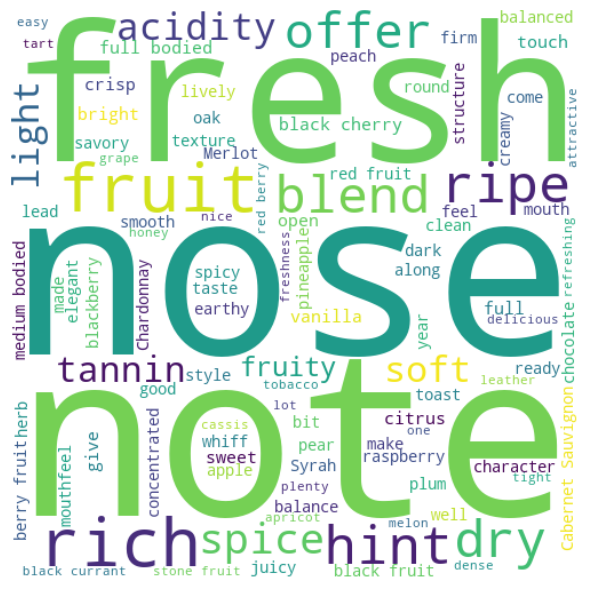

Good


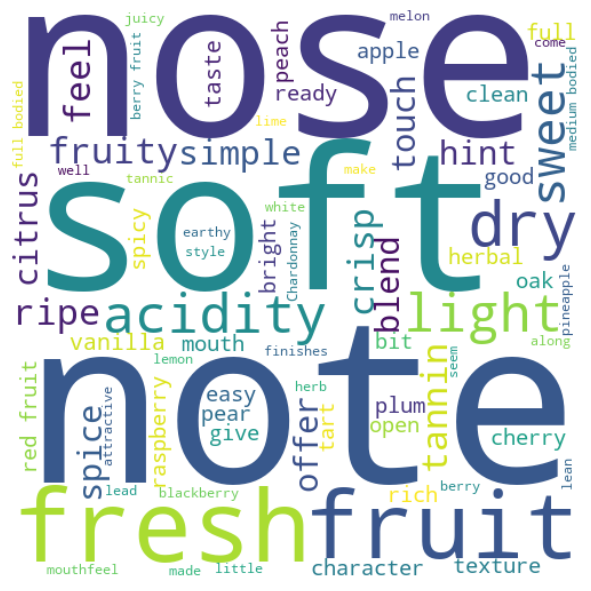

Acceptable


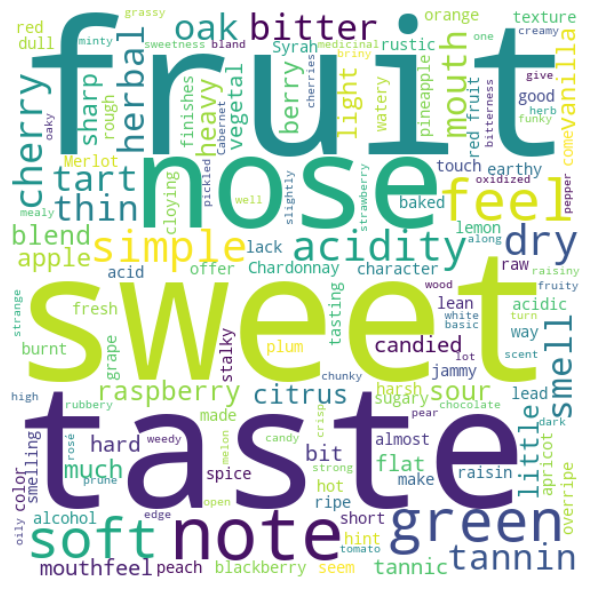

Superb


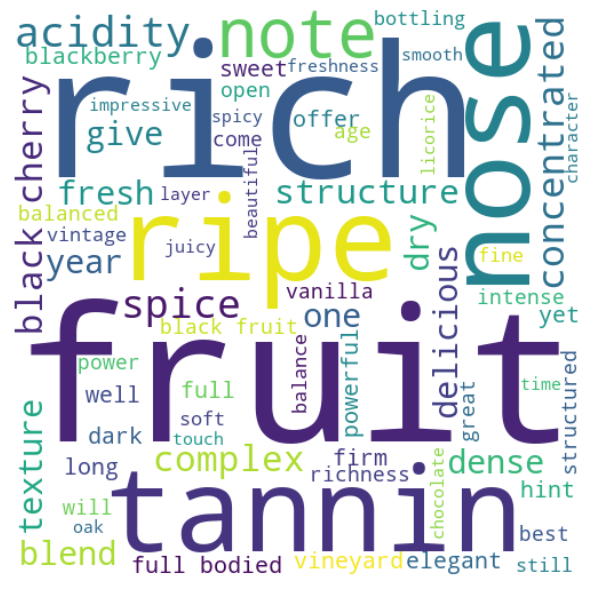

Classic


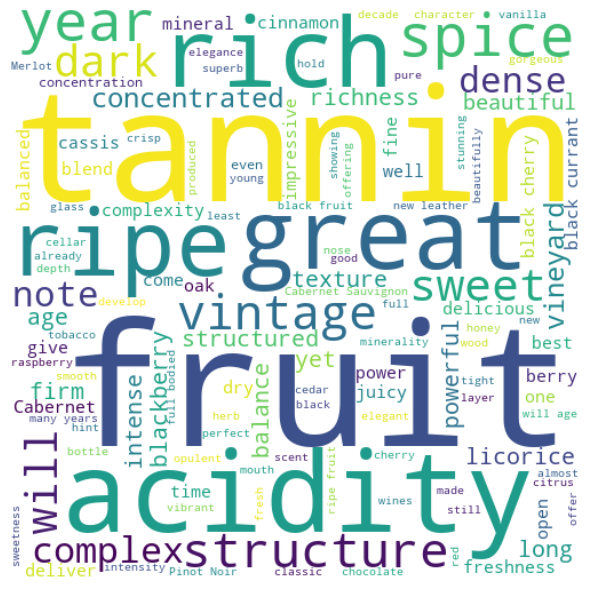

Excellent


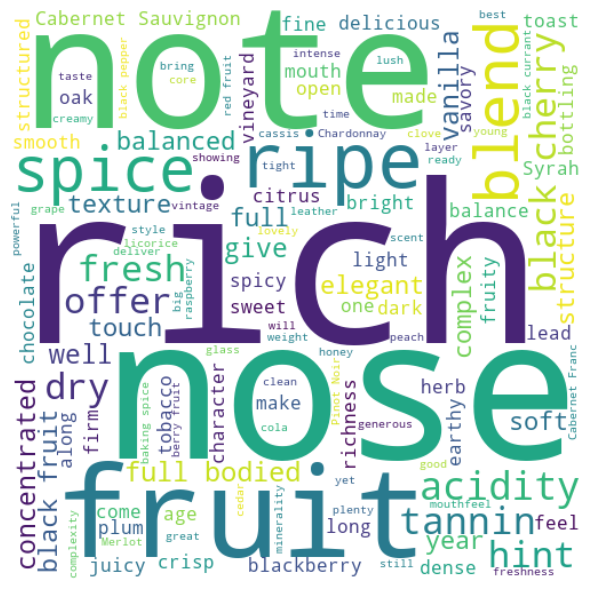

In [31]:
# Function to create the wordcloud
def createWordCloud(description, title):
    stopwords = set(STOPWORDS)
    stopwords.update(["drink", "now", "wine", "flavor", "flavors", "aromas", "aroma", "palate", "finish", "show", "shows"])

    wordcloud = WordCloud(width = 500, height = 500, min_font_size = 10, 
                    background_color ='white', stopwords=stopwords).generate(description)

    plt.imshow(wordcloud, interpolation='bilinear')
    plt.tight_layout(pad = 0)
    plt.axis("off")
    plt.show()

#Function to create the wordcloud for each point
def createWordCloudForPoint(df, pointsDescription):
    #filter by point
    dfPoint = df.loc[df['pointsDescription'] == pointsDescription]
    #join all the description
    description = " ".join(review for review in dfPoint.loc[:,'description'])
    #create wordcloud
    createWordCloud(description, 'Most used words of \'' + str(pointsDescription) + '\' category')

#remove warning
pd.set_option('mode.chained_assignment', None)

#Create wordcloud for each point
for point in set(wines2['pointsDescription']):
    print(point)
    createWordCloudForPoint(wines2, point)

#reset warning
pd.reset_option('mode.chained_assignment')